# TODO

To match the current atlas online's portfolio
* Pie scatter
* Bipartite graph
* Radial/rings
* Table (simple or with nested bars)

Others
* Bar chart (distributions)
* Pie chart
* Matrix
* Record time to generate the charts and compare with matlibplot

Interactions
* Focus on elements in sparlines, dotplots, ..
* Multiple views
* Corrdinated views
* Selection / interaction

In [1]:
import sys
sys.path.append("./modules")
import vistk
import pandas as pd
from linnaeus import classification
import json

Data source: Nigeria imports
[http://atlas.cid.harvard.edu/explore/tree_map/export/nga/all/show/2013/](http://atlas.cid.harvard.edu/explore/tree_map/export/nga/all/show/2013/)

In [2]:
with open("sourceData/nigeria_exports_2013.json") as data_file:    
    data = json.load(data_file)

In [3]:
#data = pd.read_json("sourceData/nigeria_exports_2013.json")
df = pd.DataFrame(data['data'])
df.tail()

,abbrv,code,color,community_id,community_name,distance,id,item_id,name,opp_gain,pci,rca,share,value,year
14650,9701,9701,#7f7f7f,906,Miscellaneous,0.975245,9701,1235,"Paintings, drawings and pastels, executed enti...",0.969982,3.152207,0.007768,0.000061,571738,2013
14651,9702,9702,#7f7f7f,906,Miscellaneous,0.977281,9702,1236,"Original engravings, prints and lithographs, f...",0.991694,2.894103,0.135688,0.000031,284618,2013
14652,9703,9703,#7f7f7f,906,Miscellaneous,0.972952,9703,1237,"Original sculptures and statuary, in any material",0.830454,2.306428,0.059802,0.000100,933856,2013
14653,9705,9705,#7f7f7f,906,Miscellaneous,0.952956,9705,1239,Collections and collectors pieces,0.228003,-1.209856,0.027164,0.000019,177785,2013
14654,9706,9706,#7f7f7f,906,Miscellaneous,0.973905,9706,1240,Antiques older than one hundred years,0.857302,1.814209,0.002894,0.000005,46102,2013


# Dotplot

In [5]:
dotplot = vistk.Dotplot(id='code', name='name', x='distance', year=1995, color='color', 
                        group='community_id', selection=['8422'])
dotplot.draw(df)

<IPython.core.display.Javascript object>

In [6]:
from ipywidgets import interact, interactive, fixed

def f(year=1984):
    dotplot = vistk.Dotplot(id='code', name='name', x='distance', year=year, color='color', 
                        group='community_id', selection=['8422'])
    dotplot.draw(df)

interact(f, year=[1995, 2010]);



<IPython.core.display.Javascript object>

In [7]:
dotplot

# Sparkline

In [8]:
sparkline = vistk.Sparkline(id='code', name='name', y='value', year=2013)
sparkline.draw(df)

<IPython.core.display.Javascript object>

# Scatterplot
TODO
* Filter function
* RCA > 1 function to color

In [9]:
scatterplot = vistk.Scatterplot(id='code', color='color', name='name', x='value', 
                                y='opp_gain', r='rca', year=2013)
scatterplot.draw(df)

<IPython.core.display.Javascript object>

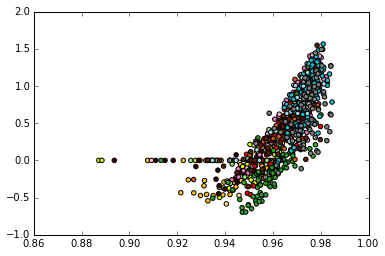

In [10]:
# Test with matplotlib
%matplotlib inline
import matplotlib.pylab as plt
df_sub = df[(df.year == 2013)]
plt.scatter(df_sub.distance, df_sub.opp_gain, c=df_sub.color)

In [11]:
scatterplot = vistk.Scatterplot(id='code', color='color', name='name', x='distance', 
                                y='opp_gain', r='rca', year=2013)
scatterplot.draw(df)

<IPython.core.display.Javascript object>

In [12]:
with open("sourceData/kuwait_exports_2013.json") as data_file:    
    data = json.load(data_file)

df_kuwait = pd.DataFrame(data['data'])
df_kuwait.head()

,abbrv,code,color,community_id,community_name,distance,id,item_id,name,opp_gain,pci,rca,share,value,year
0,0101,0101,#FFE999,106,Animal & Animal Products,0.983973,0101,1,"Live horses, asses, mules or hinnies",0.355910,0.995722,0.001058,3.244177e-07,2237.00,1995
1,0106,0106,#FFE999,106,Animal & Animal Products,0.979260,0106,6,Other live animals,-0.510715,-1.932755,0.178310,2.005052e-05,138257.00,1995
2,0202,0202,#FFE999,106,Animal & Animal Products,0.987871,0202,8,"Meat of bovine animals, frozen",-0.137296,-0.427031,0.002319,3.765271e-06,25963.17,1995
3,0207,0207,#FFE999,106,Animal & Animal Products,0.988299,0207,13,"Meat and edible offal, of the poultry of headi...",0.561586,1.572515,0.001490,3.271588e-06,22559.01,1995
4,0305,0305,#FFE999,106,Animal & Animal Products,0.977612,0305,21,"Fish, dried, salted or in brine; smoked fish, ...",-0.608127,-2.502113,0.006512,4.595487e-06,31687.87,1995


In [13]:
scatterplot = vistk.Scatterplot(id='code', color='color', name='name', x='distance', 
                                y='pci', r='value', year=2013)
scatterplot.draw(df_kuwait)

<IPython.core.display.Javascript object>

# Treemap

In [ ]:
treemap = vistk.Treemap(id='abbrv', color='color', name='name', size='value', sort='value',
                        group='community_id', year=2013)
treemap.draw(df)

In [ ]:
productspace = vistk.Productspace(id='name', year=2013, color='color', name='name')
productspace.draw(df)

# Geomap

In [14]:
import json
import pandas as pd
import sys
sys.path.append("./modules")
import vistk

with open("sourceData/countries_wdi.json") as data_file:    
    countries_wdi = json.load(data_file)

# Temporal data are nested under the 'years' attribtue
# Only retrieve the first year (1995)
countries_wdi_flat = []
i = 0
for index, item in enumerate(countries_wdi):
    for x, m in enumerate(item['years']):
        m['name'] = item['name'];        
        m['continent'] = item['continent'];
        m['country_id'] = item['country_id'];
        m['id_topo'] = item['id_topo'];
        m['longitude'] = item['longitude'];
        m['latitude'] = item['latitude'];
        m['name_3char'] = item['name_3char'];
        countries_wdi_flat.append(m)

df = pd.DataFrame(countries_wdi_flat)

In [15]:
geomap = vistk.Geomap(id='name', color='eci', name='name', year=1995)
geomap.draw(df)

<IPython.core.display.Javascript object>

# Linechart

In [ ]:
#

In [16]:
linechart = vistk.Linechart(id='name', x='year', y='eci', color='continent', name='name', selection=['Japan', 'Nigeria'])
linechart.draw(df)

<IPython.core.display.Javascript object>

In [17]:
linechart = vistk.Linechart(id='name', x='year', y='gdp', color='continent', name='name', selection=['Japan', 'Nigeria'])
linechart.draw(df)

<IPython.core.display.Javascript object>

### TODO
* Ranking chart with vertical ordinal axid

In [ ]:
df.tail()

# Grid

In [18]:
grid = vistk.Grid(id='name_3char', sort='eci', r='eci', color='continent', name='name', group='continent', year=2012)
grid.draw(df)

<IPython.core.display.Javascript object>

# Stacked graph

In [19]:
stackedgraph = vistk.Stackedgraph(id='name', x='year', y='gdp', color='continent', name='name', selection=['Japan', 'Nigeria'])
stackedgraph.draw(df)

<IPython.core.display.Javascript object>

In [20]:
with open("sourceData/world_gdp_0_1998.json") as data_file:    
    countries_gdp = json.load(data_file)

countries_gdp_flat = []
i = 0
for index, item in enumerate(countries_gdp):
    for x, m in enumerate(item['years']):
        m['name'] = item['name']
        countries_gdp_flat.append(m)

df = pd.DataFrame(countries_gdp_flat)
df.head()

,name,value,year
0,Western Europe,450.000000,0
1,Western Europe,399.992126,1000
2,Western Europe,774.341675,1500
3,Western Europe,893.965698,1600
4,Western Europe,1023.754028,1700


In [21]:
linechart = vistk.Linechart(id='name', x='year', y='value', color='name', name='name')
linechart.draw(df)

<IPython.core.display.Javascript object>